In [ ]:
import pandas as pd
import numpy as np
from google.colab import drive
from matplotlib import pyplot as plt
from sklearn.model_selection import train_test_split
from tensorflow.keras.layers import Input, Lambda, Dense, Flatten, Dropout

from tensorflow.keras.models import Model
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.applications.vgg16 import preprocess_input
from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import Sequential
import numpy as np
from glob import glob
import matplotlib.pyplot as plt

# Mounting Drive
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


<H2>1. Take at least 100 images per class with at least 3 classes using your phone/camera (e.g. take photos of different types of trees, flowers or animals). Display 5 examples from each class. [10 points]</H2>

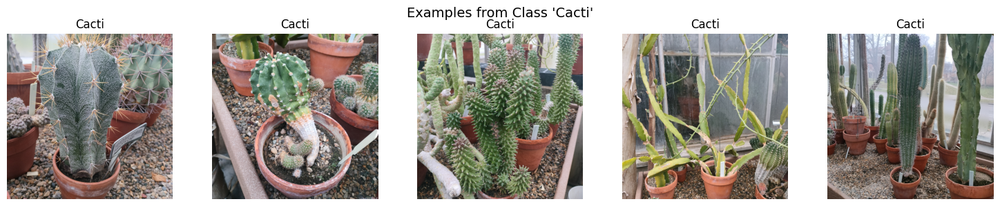

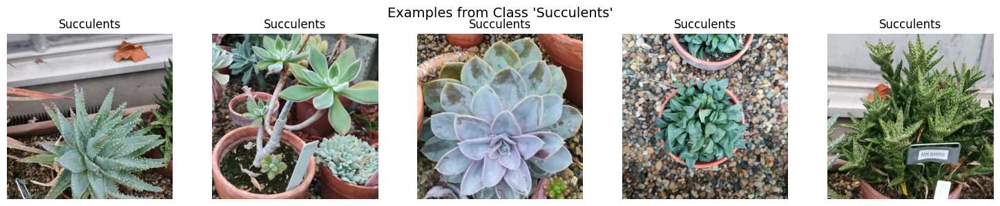

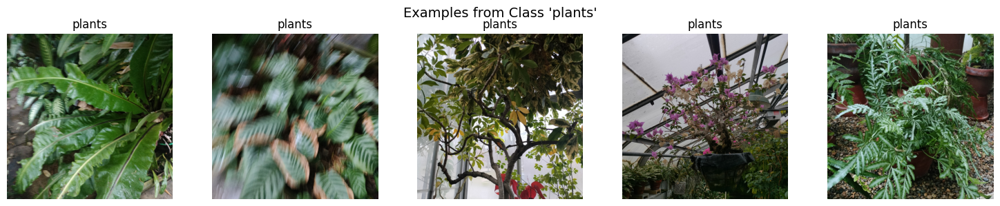

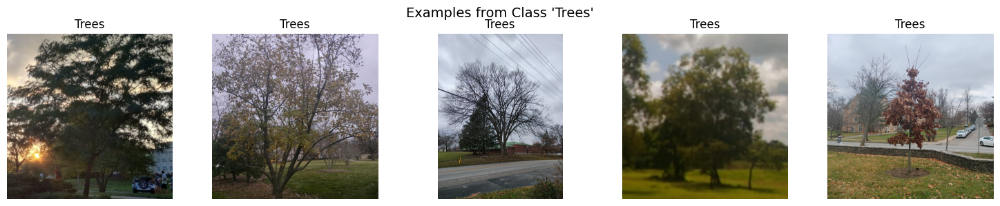

In [ ]:
import matplotlib.pyplot as plt
import os
import random
from PIL import Image

# Assuming your dataset is structured with a separate folder for each class
dataset_path = '/content/drive/My Drive/Colab Notebooks/AML/AML_HW4/Dataset/Train' #'/content/drive/MyDrive/Dataset/Train'  # Update this path to your dataset

# Number of images to display per class
num_images = 5

# Loop through each folder (class) in the dataset
for class_name in os.listdir(dataset_path):
    class_path = os.path.join(dataset_path, class_name)

    # Check if it's a directory
    if os.path.isdir(class_path):
        # Get all image files in this directory
        image_files = [file for file in os.listdir(class_path) if file.endswith(('jpg', 'jpeg', 'png'))]

        # Randomly select 5 images (or fewer if not enough images)
        selected_images = random.sample(image_files, min(num_images, len(image_files)))

        # Display the images
        plt.figure(figsize=(15, 3))
        for i, image_file in enumerate(selected_images):
            img_path = os.path.join(class_path, image_file)
            img = Image.open(img_path)
            plt.subplot(1, num_images, i + 1)
            plt.imshow(img)
            plt.title(f"{class_name}")
            plt.axis("off")
        plt.suptitle(f"Examples from Class '{class_name}'", fontsize=14)
        plt.tight_layout()
        plt.subplots_adjust(top=0.85)  # Adjust the top margin
        plt.show()

<H1>
Ans 1. -
</H1>

<h2>
As seen above, 100 images per 3 classes have been created. 5 of each have been displayed.

</H2>

<H2>

2. Split the images into a training set, a validation set, and a test set. [5 points]

      And,

3. Build the input pipeline, including the appropriate preprocessing operations, and add data augmentation. [10 points]

</H2>


In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import os

# Initialize the data generator without any augmentation
datagen = ImageDataGenerator()

# Assuming your dataset is structured with a separate folder for each class
dataset_path = '/content/drive/My Drive/Colab Notebooks/AML/AML_HW4/Dataset/Train'# '/content/drive/MyDrive/Dataset/Train'  # Update this path to your dataset

# Load the data using flow_from_directory
data_generator = datagen.flow_from_directory(
    dataset_path,
    target_size=(224, 224),  # Or any size you require
    batch_size=32,           # Batch size (can be any number since we're just counting)
    class_mode='categorical' # Assuming you're doing a categorical classification
)

# Count the images in each class
class_counts = {class_name: 0 for class_name in data_generator.class_indices.keys()}

for class_index in data_generator.classes:
    class_name = list(data_generator.class_indices.keys())[class_index]
    class_counts[class_name] += 1

# Print the counts
for class_name, count in class_counts.items():
    print(f"Class '{class_name}': {count} images")

Found 353 images belonging to 4 classes.
Class 'Cacti': 65 images
Class 'Succulents': 102 images
Class 'Trees': 64 images
Class 'plants': 122 images


In [ ]:
# Pipeline & Splitting the Data

# Rescale all images by 1./255
Train_datagen = ImageDataGenerator(rescale=1./255,
                            validation_split=0.2,
                            rotation_range=40,
                            width_shift_range=0.2,
                            height_shift_range=0.2,
                            shear_range=0.2,
                            zoom_range=0.2,
                            horizontal_flip=True,
                            fill_mode='nearest')

validation_test_datagen = ImageDataGenerator(rescale=1./255,validation_split=0.2)

# Define the batch size
batch_size = 32

# Define the image size
target_size = (224, 224)

# Define the class mode
class_mode = 'categorical'

# Loading and splitting the training data for training and validation
train_generator = Train_datagen.flow_from_directory(
    '/content/drive/My Drive/Colab Notebooks/AML/AML_HW4/Dataset/Train', #'/content/drive/MyDrive/Dataset/Train',
    target_size=target_size,
    batch_size=batch_size,
    class_mode=class_mode,
    subset='training',  # Set as training data
    seed=42)  # For reproducibility

validation_generator = validation_test_datagen.flow_from_directory(
    '/content/drive/My Drive/Colab Notebooks/AML/AML_HW4/Dataset/Train',#'/content/drive/MyDrive/Dataset/Train',  # Same directory as training data
    target_size=target_size,
    batch_size=batch_size,
    class_mode=class_mode,
    subset='validation',  # Set as validation data
    seed=42)  # For reproducibility

# Loading the test data
test_generator = validation_test_datagen.flow_from_directory(
    '/content/drive/My Drive/Colab Notebooks/AML/AML_HW4/Dataset/Test', #'/content/drive/MyDrive/Dataset/Test',
    target_size=target_size,
    batch_size=batch_size,
    class_mode=class_mode)


Found 284 images belonging to 4 classes.
Found 69 images belonging to 4 classes.
Found 75 images belonging to 4 classes.


<H1> Ans 3. - </H1>
<H2>

* In the above cell we have built a Pipeline to Augment & Pre-process our data.

* In the same cell we have Splitting the Data into Training, Testing & Validation set.
</H2>

In [ ]:
# Classifying Lables

from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Initialize the data generator
datagen = ImageDataGenerator()

# Path to your dataset directory
dataset_path = '/content/drive/My Drive/Colab Notebooks/AML/AML_HW4/Dataset/Train'#'/content/drive/MyDrive/Dataset/Train'

# Load the data
data_generator = datagen.flow_from_directory(
    dataset_path,
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical'
)

# Get the class indices
class_indices = data_generator.class_indices

# Print the class indices
print("Class labels assigned by ImageDataGenerator:")
for class_name, class_label in class_indices.items():
    print(f"Class '{class_name}': Label {class_label}")

Found 353 images belonging to 4 classes.
Class labels assigned by ImageDataGenerator:
Class 'Cacti': Label 0
Class 'Succulents': Label 1
Class 'Trees': Label 2
Class 'plants': Label 3


<H1> Ans 2. & 3. - </H1>

<H2>

1. Dataset Make-up -
  - Class 'Cacti': 65 images
  - Class 'Succulents': 102 images
  - Class 'Trees': 64 images
  - Class 'plants': 122 images

2. Created training, validation and testing set
  - Training set: 285 images
  - Validation set: 69 images
  - Test set: 75 images

3. Labels Classificied as -
  - Class 'Cacti': Label 0
  - Class 'Succulents': Label 1
  - Class 'Trees': Label 2
  - Class 'plants': Label 3
</H2>


<H2>4. Fine-tune a pretrained model of your choice on this dataset (the one you created in part 3). Report classification accuracy and give a few examples of correct/incorrect classification (show a few images that were correctly/incorrectly classified).</H2>

In [ ]:
# re-size all the images to this
IMAGE_SIZE = [224, 224]
train_path = '/content/drive/My Drive/Colab Notebooks/AML/AML_HW4/Dataset/Train'#'/content/drive/MyDrive/Dataset/Train/'
valid_path = '/content/drive/My Drive/Colab Notebooks/AML/AML_HW4/Dataset/Test'#'/content/drive/MyDrive/Dataset/Test/'

In [ ]:
# add preprocessing layer to the front of VGG
vgg = VGG16(input_shape=IMAGE_SIZE + [3], weights='imagenet', include_top=False)

# don't train existing weights
for layer in vgg.layers:
    layer.trainable = False

In [ ]:
  # useful for getting number of classes
folders = glob('/content/drive/My Drive/Colab Notebooks/AML/AML_HW4/Dataset/Train/*')#'/content/drive/MyDrive/Dataset/Train/*')

<H1>Pre-Trained Model Tuning</H1>

<H1>Dropout = 0.7 | Epochs = 15</H1>

In [ ]:

# Flatten the output layer to 1 dimension
x = Flatten()(vgg.output)

# Add a fully connected layer with 512 hidden units and ReLU activation
x = Dense(64, activation='relu')(x)

# Add a dropout rate of 0.5
x = Dropout(0.7)(x)

# Add a final softmax layer for classification
predictions = Dense(len(folders), activation='softmax')(x)

In [ ]:
# create a model object
model_1 = Model(inputs=vgg.input, outputs=predictions)

In [ ]:
# view the structure of the model
model_1.summary()

Model: "model_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0   

In [ ]:
# tell the model what cost and optimization method to use
model_1.compile(
  loss='categorical_crossentropy',
  optimizer='adam',
  metrics=['accuracy']
)

In [ ]:
# Fit the model
r = model_1.fit(
    train_generator,  # Use the training generator
    validation_data=validation_generator,  # Use the validation generator for validation data
    epochs= 15,
    steps_per_epoch=len(train_generator),
    validation_steps=len(validation_generator)
)

Epoch 1/15
9/9 [==============================] - 51s 6s/step - loss: 2.6955 - accuracy: 0.3099 - val_loss: 1.1972 - val_accuracy: 0.4928
Epoch 2/15
9/9 [==============================] - 50s 6s/step - loss: 1.3060 - accuracy: 0.2535 - val_loss: 1.2073 - val_accuracy: 0.4783
Epoch 3/15
9/9 [==============================] - 45s 5s/step - loss: 1.2560 - accuracy: 0.3697 - val_loss: 1.0653 - val_accuracy: 0.5072
Epoch 4/15
9/9 [==============================] - 42s 5s/step - loss: 1.1841 - accuracy: 0.4296 - val_loss: 1.1115 - val_accuracy: 0.5652
Epoch 5/15
9/9 [==============================] - 47s 5s/step - loss: 1.2424 - accuracy: 0.4120 - val_loss: 1.0010 - val_accuracy: 0.5217
Epoch 6/15
9/9 [==============================] - 43s 5s/step - loss: 1.1573 - accuracy: 0.4542 - val_loss: 0.9248 - val_accuracy: 0.5072
Epoch 7/15
9/9 [==============================] - 43s 5s/step - loss: 1.1392 - accuracy: 0.4331 - val_loss: 0.9746 - val_accuracy: 0.5362
Epoch 8/15
9/9 [==================

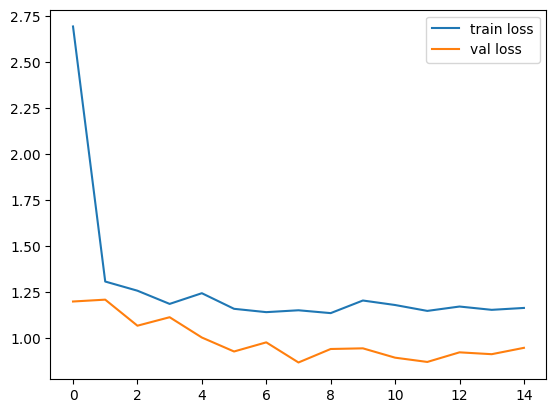

<Figure size 640x480 with 0 Axes>

In [ ]:
# loss
plt.plot(r.history['loss'], label='train loss')
plt.plot(r.history['val_loss'], label='val loss')
plt.legend()
plt.show()
plt.savefig('LossVal_loss')

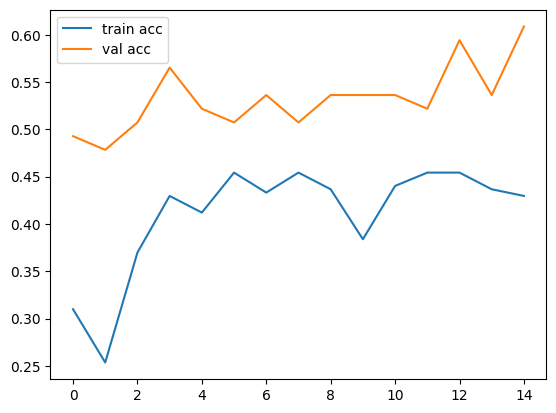

<Figure size 640x480 with 0 Axes>

In [ ]:
# accuracies
plt.plot(r.history['accuracy'], label='train acc')
plt.plot(r.history['val_accuracy'], label='val acc')
plt.legend()
plt.show()
plt.savefig('AccVal_acc')

<H1> Dropout = 0.4 | Epochs = 12</H1>

In [ ]:
# Flatten the output layer to 1 dimension
x = Flatten()(vgg.output)

# Add a fully connected layer with 512 hidden units and ReLU activation
x = Dense(64, activation='relu')(x)

# Add a dropout rate of 0.4
x = Dropout(0.4)(x)

# Add a final softmax layer for classification
predictions = Dense(len(folders), activation='softmax')(x)

# create a model object
model_2 = Model(inputs=vgg.input, outputs=predictions)

# view the structure of the model
model_2.summary()

Model: "model_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_3 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0   

In [ ]:
# tell the model what cost and optimization method to use
model_2.compile(
  loss='categorical_crossentropy',
  optimizer='adam',
  metrics=['accuracy']
)

In [ ]:
# Fit the model
r = model_2.fit(
    train_generator,  # Use the training generator
    validation_data=validation_generator,  # Use the validation generator for validation data
    epochs= 12,
    steps_per_epoch=len(train_generator),
    validation_steps=len(validation_generator)
)

Epoch 1/12
9/9 [==============================] - 47s 5s/step - loss: 2.8476 - accuracy: 0.3345 - val_loss: 1.1094 - val_accuracy: 0.5507
Epoch 2/12
9/9 [==============================] - 42s 5s/step - loss: 1.2209 - accuracy: 0.3944 - val_loss: 1.0395 - val_accuracy: 0.5217
Epoch 3/12
9/9 [==============================] - 43s 5s/step - loss: 1.1449 - accuracy: 0.4296 - val_loss: 0.9840 - val_accuracy: 0.6087
Epoch 4/12
9/9 [==============================] - 42s 5s/step - loss: 1.0631 - accuracy: 0.4507 - val_loss: 0.7880 - val_accuracy: 0.6377
Epoch 5/12
9/9 [==============================] - 42s 5s/step - loss: 1.0017 - accuracy: 0.4225 - val_loss: 0.7427 - val_accuracy: 0.6957
Epoch 6/12
9/9 [==============================] - 43s 5s/step - loss: 0.9987 - accuracy: 0.5810 - val_loss: 0.7504 - val_accuracy: 0.6812
Epoch 7/12
9/9 [==============================] - 40s 4s/step - loss: 0.9102 - accuracy: 0.5915 - val_loss: 0.7240 - val_accuracy: 0.6522
Epoch 8/12
9/9 [==================

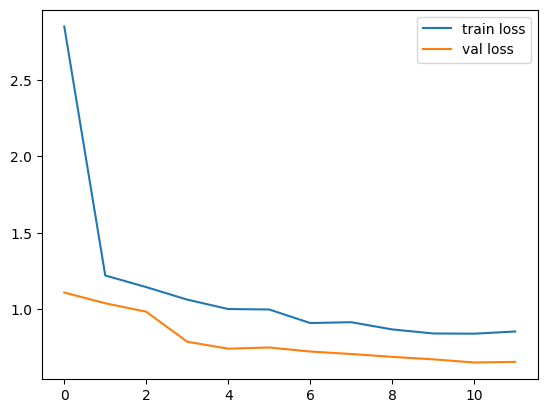

<Figure size 640x480 with 0 Axes>

In [ ]:
# loss
plt.plot(r.history['loss'], label='train loss')
plt.plot(r.history['val_loss'], label='val loss')
plt.legend()
plt.show()
plt.savefig('LossVal_loss')

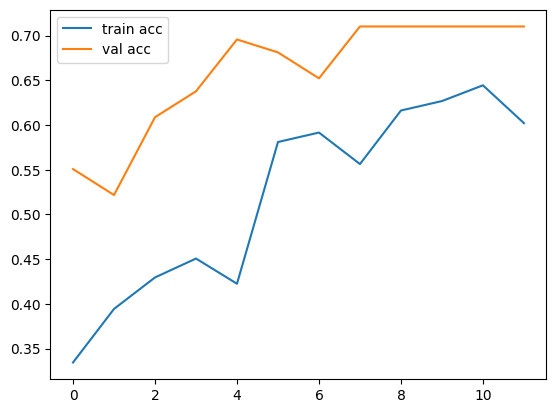

<Figure size 640x480 with 0 Axes>

In [ ]:
# accuracies
plt.plot(r.history['accuracy'], label='train acc')
plt.plot(r.history['val_accuracy'], label='val acc')
plt.legend()
plt.show()
plt.savefig('AccVal_acc')

<H1>Dropout = 0.3 | Epochs = 10 </H1>

In [ ]:
# Flatten the output layer to 1 dimension
x = Flatten()(vgg.output)

# Add a fully connected layer with 512 hidden units and ReLU activation
x = Dense(64, activation='relu')(x)

# Add a dropout rate of 0.3
x = Dropout(0.3)(x)

# Add a final softmax layer for classification
predictions = Dense(len(folders), activation='softmax')(x)

# create a model object
model_3 = Model(inputs=vgg.input, outputs=predictions)

# view the structure of the model
model_3.summary()

Model: "model_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0   

In [ ]:
# tell the model what cost and optimization method to use
model_3.compile(
  loss='categorical_crossentropy',
  optimizer='adam',
  metrics=['accuracy']
)

In [ ]:
# Fit the model
r = model_3.fit(
    train_generator,  # Use the training generator
    validation_data=validation_generator,  # Use the validation generator for validation data
    epochs= 10,
    steps_per_epoch=len(train_generator),
    validation_steps=len(validation_generator)
)

Epoch 1/10
9/9 [==============================] - 48s 5s/step - loss: 3.0631 - accuracy: 0.3697 - val_loss: 1.2212 - val_accuracy: 0.4058
Epoch 2/10
9/9 [==============================] - 41s 5s/step - loss: 1.1454 - accuracy: 0.4754 - val_loss: 1.0517 - val_accuracy: 0.5652
Epoch 3/10
9/9 [==============================] - 43s 5s/step - loss: 1.0413 - accuracy: 0.5282 - val_loss: 0.9467 - val_accuracy: 0.6232
Epoch 4/10
9/9 [==============================] - 44s 5s/step - loss: 0.9454 - accuracy: 0.6056 - val_loss: 0.9210 - val_accuracy: 0.6812
Epoch 5/10
9/9 [==============================] - 40s 5s/step - loss: 0.9070 - accuracy: 0.5951 - val_loss: 0.8720 - val_accuracy: 0.6667
Epoch 6/10
9/9 [==============================] - 41s 5s/step - loss: 0.8648 - accuracy: 0.5915 - val_loss: 0.9114 - val_accuracy: 0.6232
Epoch 7/10
9/9 [==============================] - 43s 5s/step - loss: 0.8765 - accuracy: 0.6092 - val_loss: 0.8630 - val_accuracy: 0.7101
Epoch 8/10
9/9 [==================

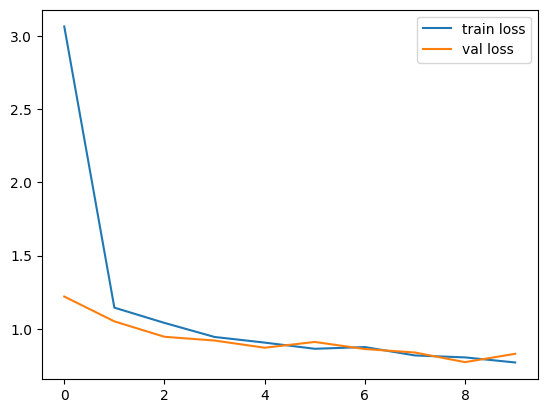

<Figure size 640x480 with 0 Axes>

In [ ]:
# loss
plt.plot(r.history['loss'], label='train loss')
plt.plot(r.history['val_loss'], label='val loss')
plt.legend()
plt.show()
plt.savefig('LossVal_loss')

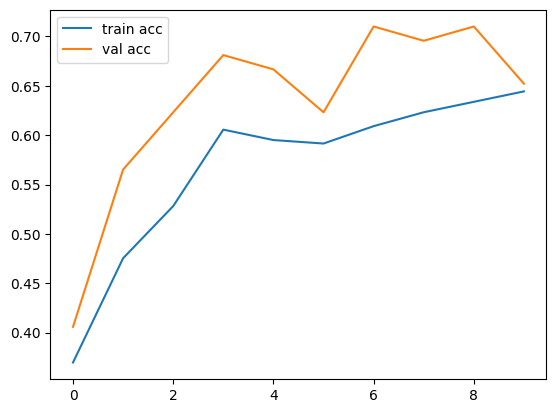

<Figure size 640x480 with 0 Axes>

In [ ]:
# accuracies
plt.plot(r.history['accuracy'], label='train acc')
plt.plot(r.history['val_accuracy'], label='val acc')
plt.legend()
plt.show()
plt.savefig('AccVal_acc')

<H1>Ans 4. - </H1>
<H2> We train/test 3 models with different hyperparameters and selected the model with the best Val_Accuracy -

  1. Dropout = 0.7 | Epochs = 15 | Val_Accuracy = smaller than (<) 70%
  2. Dropout = 0.4 | Epochs = 12 | Val_Accuracy = greater than (>) 70%
  3. Dropout = 0.3 | Epochs = 10 | Val_Accuracy = smaller than (<) 70%

Best Model Selected = Dropout = 0.4 | Epochs = 12 | Accuracy = greater than (>) 70%

</H2>

In [ ]:
import tensorflow as tf

from tensorflow.keras.models import load_model

model.save('facerecognition_Vgg16.h5')

In [ ]:
# Evaluate the model on the test data using `evaluate`
test_loss, test_accuracy = model_2.evaluate(test_generator, steps=len(test_generator))

# Print the test loss and accuracy
print("Test Loss:", test_loss)
print("Test Accuracy:", test_accuracy)

3/3 [==============================] - 9s 3s/step - loss: 0.7387 - accuracy: 0.6267
Test Loss: 0.7386859059333801
Test Accuracy: 0.6266666650772095


1/1 [==============================] - 0s 27ms/step


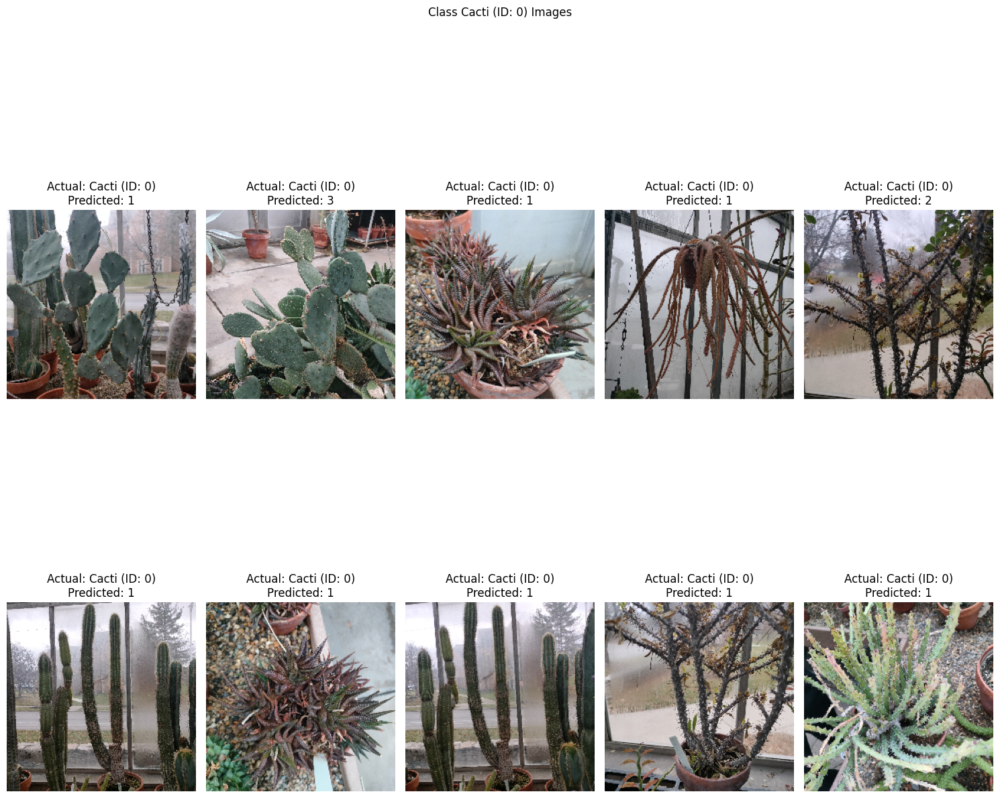

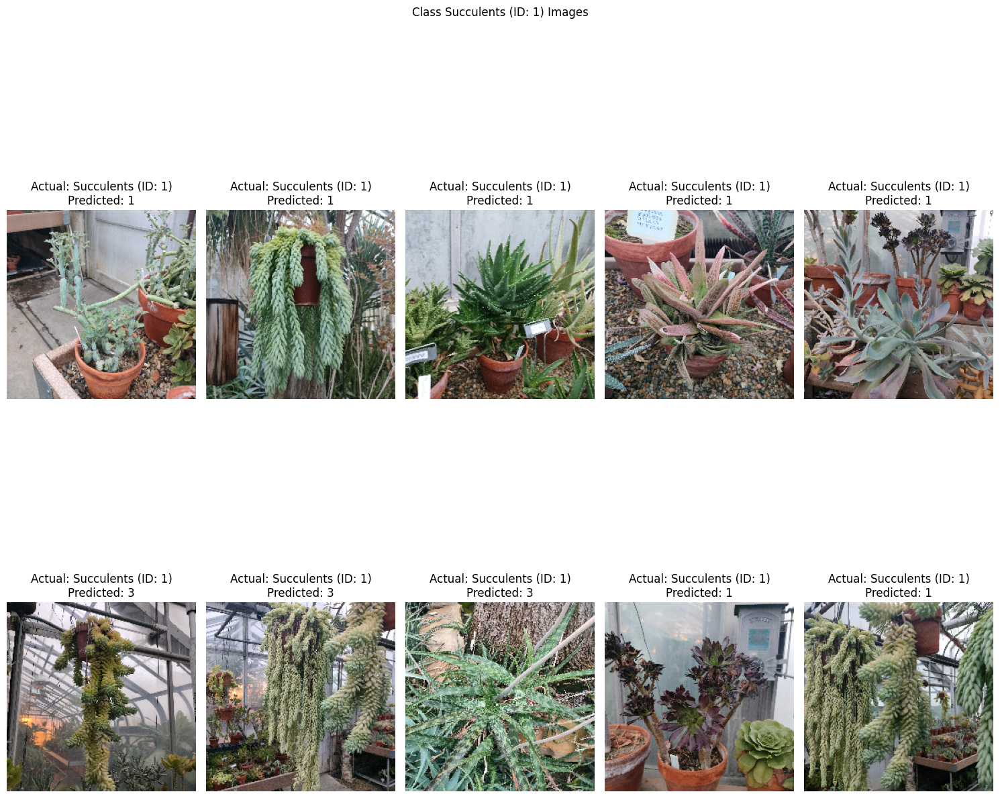

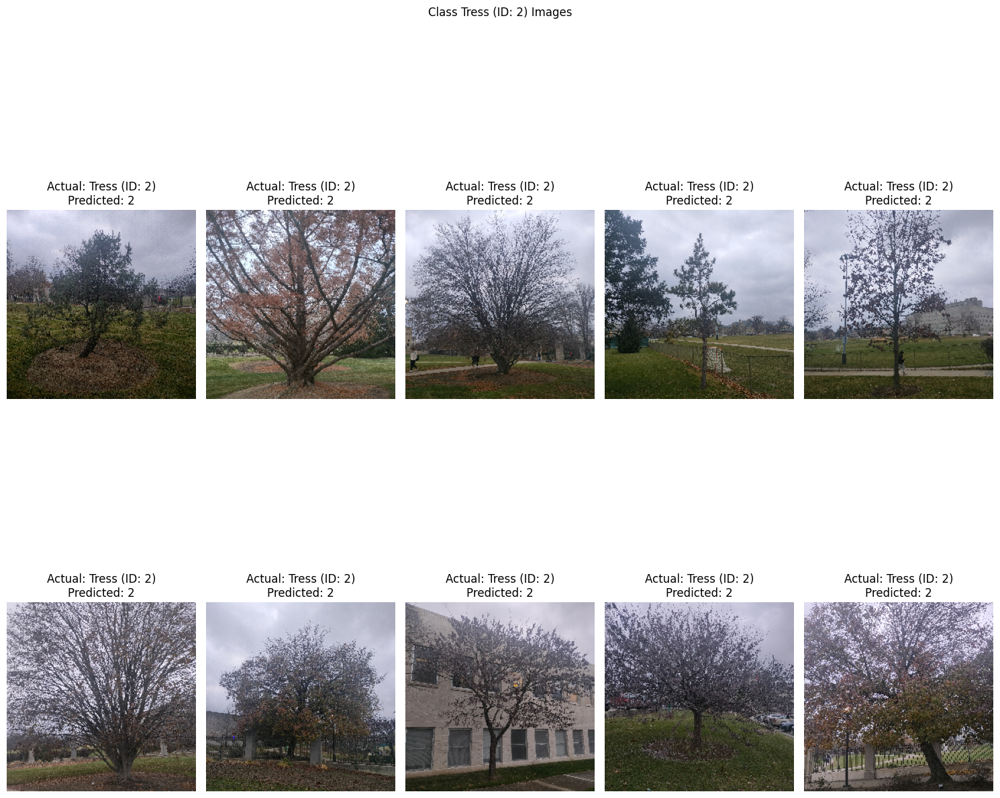

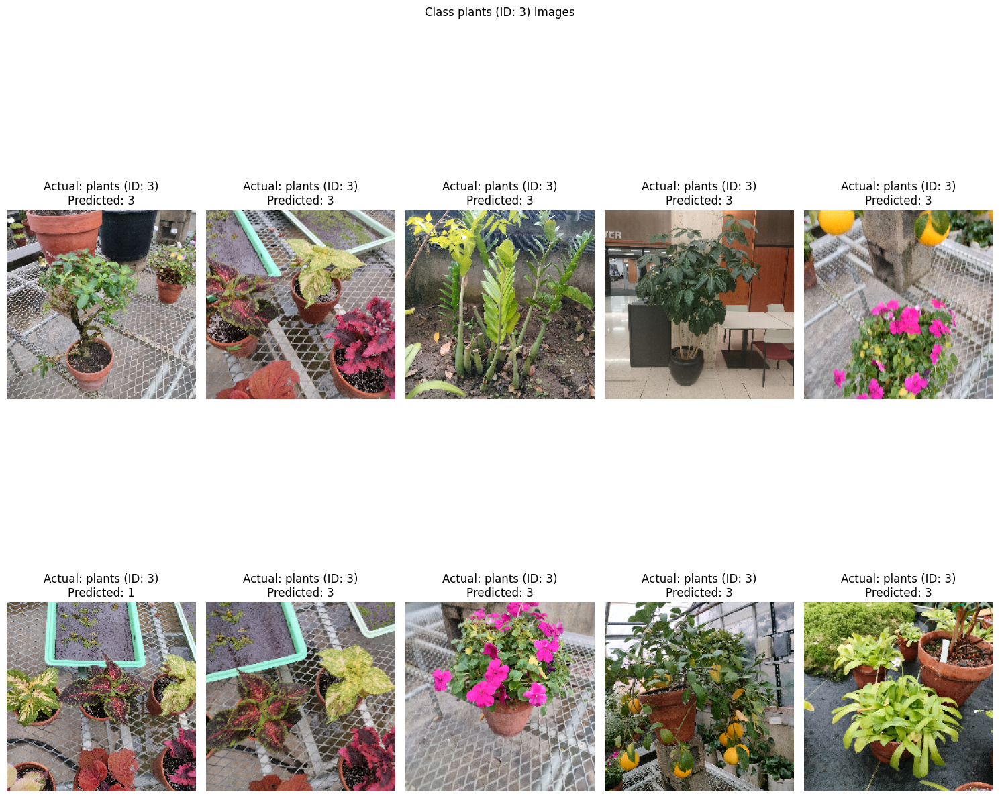

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Number of classes
num_classes = len(test_generator.class_indices)

# Initialize a dictionary to store images
class_images = {class_id: [] for class_id in range(num_classes)}
class_labels = {class_id: [] for class_id in range(num_classes)}

# Iterate over the test set to collect 10 images for each class
for test_images, test_labels in test_generator:
    # Predict the labels for this batch of test images
    predicted_labels = model_2.predict(test_images)
    predicted_labels = np.argmax(predicted_labels, axis=1)
    actual_labels = np.argmax(test_labels, axis=1)

    for i in range(len(test_images)):
        actual_label = actual_labels[i]
        # Collect images for each class
        if len(class_images[actual_label]) < 10:
            class_images[actual_label].append(test_images[i])
            class_labels[actual_label].append(predicted_labels[i])

    # Break the loop if 10 images of each class have been collected
    if all(len(images) == 10 for images in class_images.values()):
        break

# Display 10 images of each class
# Create a dictionary mapping from class ID to class name
id_to_class = {v: k for k, v in test_generator.class_indices.items()}

# Display 10 images of each class
for class_id in range(num_classes):
    plt.figure(figsize=(15, 15))
    class_name = id_to_class[class_id]  # Get the class name using class ID
    for i, (image, predicted_label) in enumerate(zip(class_images[class_id], class_labels[class_id])):
        plt.subplot(2, 5, i + 1)
        plt.imshow(image)
        plt.title(f"Actual: {class_name} (ID: {class_id})\nPredicted: {predicted_label}")
        plt.axis("off")
    plt.suptitle(f"Class {class_name} (ID: {class_id}) Images")
    plt.tight_layout()
    plt.show()

<H1>Ans 4. - </H1>
<H2>

1. As seen from above there are certain images that have been correctly identified, and some have not been correctly identified.
2. We observed that the incorrect image classification was majorily for the 'Cacti' class.
3. Minor incorrections were observed when predicting 'Plants' & 'Succulents' classes.
4. Whereas the class 'Tree' was classified perfectly (~100% accuracy).
</H2>


<H2>5. Train from scratch (without pretraining) a deep neural network that contains convolutional layers on this dataset (the one you created in part 3). Report classification accuracy and give a few examples of correct/incorrect classification (show a few images that were correctly/incorrectly classified). Note: The objective of this question is to illustrate that training deep networks from scratch requires a lot of data so it is ok if your classification accuracy is low. [15 points]
</H2>

<H1>Tuning our CNN Model - </H1>

<h2>Model 1 -</h2>

In [ ]:
from keras.preprocessing.image import ImageDataGenerator
from keras.models import Sequential
from keras.layers import Conv2D, MaxPooling2D
from keras.layers import Activation, Dropout, Flatten, Dense

SIZE = 224

INPUT_SHAPE = (SIZE, SIZE, 3)   #change to (SIZE, SIZE, 3)

model_cnn = Sequential()
model_cnn.add(Conv2D(128, (3, 3), input_shape=INPUT_SHAPE))
model_cnn.add(Activation('relu'))
model_cnn.add(MaxPooling2D(pool_size=(2, 2)))

model_cnn.add(Conv2D(64, (3, 3)))
model_cnn.add(Activation('relu'))
model_cnn.add(MaxPooling2D(pool_size=(2, 2)))

model_cnn.add(Conv2D(32, (3, 3)))
model_cnn.add(Activation('relu'))
model_cnn.add(MaxPooling2D(pool_size=(2, 2)))

model_cnn.add(Conv2D(16, (3, 3)))
model_cnn.add(Activation('relu'))
model_cnn.add(MaxPooling2D(pool_size=(2, 2)))

model_cnn.add(Flatten())
model_cnn.add(Dense(8))
model_cnn.add(Activation('relu'))
model_cnn.add(Dropout(0.2))
model_cnn.add(Dense(4))
model_cnn.add(Activation('softmax'))

# tell the model what cost and optimization method to use
model_cnn.compile(
  loss='categorical_crossentropy',
  optimizer='adam',
  metrics=['accuracy']
)

print(model_cnn.summary())

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_8 (Conv2D)           (None, 222, 222, 128)     3584      
                                                                 
 activation_12 (Activation)  (None, 222, 222, 128)     0         
                                                                 
 max_pooling2d_8 (MaxPoolin  (None, 111, 111, 128)     0         
 g2D)                                                            
                                                                 
 conv2d_9 (Conv2D)           (None, 109, 109, 64)      73792     
                                                                 
 activation_13 (Activation)  (None, 109, 109, 64)      0         
                                                                 
 max_pooling2d_9 (MaxPoolin  (None, 54, 54, 64)        0         
 g2D)                                                 

In [ ]:
# Fit the model
cnn = model_cnn.fit(
    train_generator,  # Use the training generator
    validation_data=validation_generator,  # Use the validation generator for validation data
    epochs=5,
    steps_per_epoch=len(train_generator),
    validation_steps=len(validation_generator)
)

Epoch 1/5
9/9 [==============================] - 46s 5s/step - loss: 1.3871 - accuracy: 0.2183 - val_loss: 1.3838 - val_accuracy: 0.2174
Epoch 2/5
9/9 [==============================] - 43s 5s/step - loss: 1.3827 - accuracy: 0.3204 - val_loss: 1.3785 - val_accuracy: 0.4348
Epoch 3/5
9/9 [==============================] - 40s 5s/step - loss: 1.3817 - accuracy: 0.3239 - val_loss: 1.3788 - val_accuracy: 0.3768
Epoch 4/5
9/9 [==============================] - 42s 5s/step - loss: 1.3787 - accuracy: 0.3627 - val_loss: 1.3742 - val_accuracy: 0.3043
Epoch 5/5
9/9 [==============================] - 42s 5s/step - loss: 1.3751 - accuracy: 0.3028 - val_loss: 1.3749 - val_accuracy: 0.3768


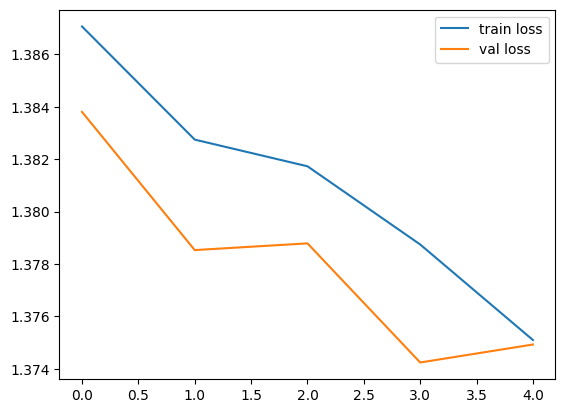

<Figure size 640x480 with 0 Axes>

In [ ]:
# loss
plt.plot(cnn.history['loss'], label='train loss')
plt.plot(cnn.history['val_loss'], label='val loss')
plt.legend()
plt.show()
plt.savefig('LossVal_loss')

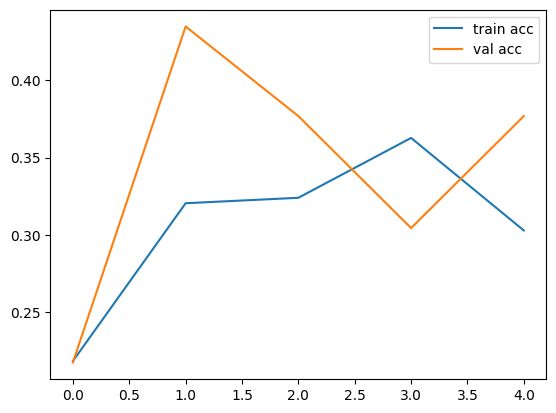

<Figure size 640x480 with 0 Axes>

In [ ]:
# accuracies
plt.plot(cnn.history['accuracy'], label='train acc')
plt.plot(cnn.history['val_accuracy'], label='val acc')
plt.legend()
plt.show()
plt.savefig('AccVal_acc')

In [ ]:
# Evaluate the model on the test data using `evaluate`
test_loss, test_accuracy = model_cnn.evaluate(test_generator, steps=len(test_generator))

# Print the test loss and accuracy
print("Test Loss:", test_loss)
print("Test Accuracy:", test_accuracy)

3/3 [==============================] - 9s 3s/step - loss: 1.3857 - accuracy: 0.2800
Test Loss: 1.385651707649231
Test Accuracy: 0.2800000011920929


<H2> Model 2 -</H2>

In [112]:
from keras.preprocessing.image import ImageDataGenerator
from keras.models import Sequential
from keras.layers import Conv2D, MaxPooling2D
from keras.layers import Activation, Dropout, Flatten, Dense

SIZE = 224

INPUT_SHAPE = (SIZE, SIZE, 3)   #change to (SIZE, SIZE, 3)

model_cnn_2 = Sequential()
model_cnn_2.add(Conv2D(256, (4, 4), input_shape=INPUT_SHAPE))
model_cnn_2.add(Activation('relu'))
model_cnn_2.add(MaxPooling2D(pool_size=(2, 2)))

model_cnn_2.add(Conv2D(64, (4, 4)))
model_cnn_2.add(Activation('relu'))
model_cnn_2.add(MaxPooling2D(pool_size=(2, 2)))

# model_cnn_2.add(Conv2D(32, (3, 3)))
# model_cnn_2.add(Activation('relu'))
# model_cnn_2.add(MaxPooling2D(pool_size=(2, 2)))

model_cnn_2.add(Conv2D(16, (4, 4)))
model_cnn_2.add(Activation('relu'))
model_cnn_2.add(MaxPooling2D(pool_size=(2, 2)))

model_cnn_2.add(Flatten())
model_cnn_2.add(Dense(8))
model_cnn_2.add(Activation('relu'))
model_cnn_2.add(Dropout(0.3))
model_cnn_2.add(Dense(4))
model_cnn_2.add(Activation('softmax'))

# tell the model what cost and optimization method to use
model_cnn_2.compile(
  loss='categorical_crossentropy',
  optimizer='adam',
  metrics=['accuracy']
)

print(model_cnn_2.summary())

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_15 (Conv2D)          (None, 221, 221, 256)     12544     
                                                                 
 activation_23 (Activation)  (None, 221, 221, 256)     0         
                                                                 
 max_pooling2d_15 (MaxPooli  (None, 110, 110, 256)     0         
 ng2D)                                                           
                                                                 
 conv2d_16 (Conv2D)          (None, 107, 107, 64)      262208    
                                                                 
 activation_24 (Activation)  (None, 107, 107, 64)      0         
                                                                 
 max_pooling2d_16 (MaxPooli  (None, 53, 53, 64)        0         
 ng2D)                                                

In [113]:
# Fit the model
cnn_2 = model_cnn.fit(
    train_generator,  # Use the training generator
    validation_data=validation_generator,  # Use the validation generator for validation data
    epochs=5,
    steps_per_epoch=len(train_generator),
    validation_steps=len(validation_generator)
)

Epoch 1/5
9/9 [==============================] - 45s 5s/step - loss: 1.3692 - accuracy: 0.3486 - val_loss: 1.3701 - val_accuracy: 0.3333
Epoch 2/5
9/9 [==============================] - 39s 4s/step - loss: 1.3671 - accuracy: 0.3380 - val_loss: 1.3533 - val_accuracy: 0.4203
Epoch 3/5
9/9 [==============================] - 40s 4s/step - loss: 1.3545 - accuracy: 0.3803 - val_loss: 1.3604 - val_accuracy: 0.3623
Epoch 4/5
9/9 [==============================] - 40s 5s/step - loss: 1.3629 - accuracy: 0.3556 - val_loss: 1.3363 - val_accuracy: 0.4058
Epoch 5/5
9/9 [==============================] - 41s 5s/step - loss: 1.3366 - accuracy: 0.3838 - val_loss: 1.3175 - val_accuracy: 0.3623


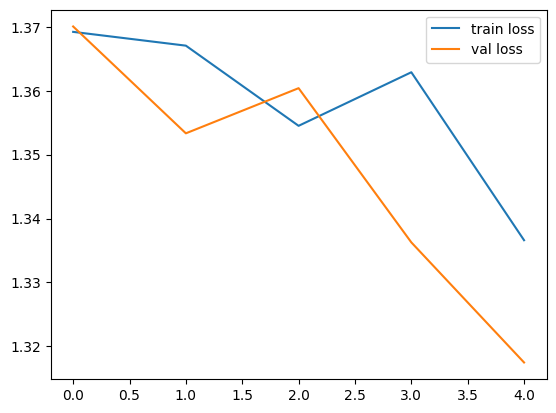

<Figure size 640x480 with 0 Axes>

In [114]:
# loss
plt.plot(cnn_2.history['loss'], label='train loss')
plt.plot(cnn_2.history['val_loss'], label='val loss')
plt.legend()
plt.show()
plt.savefig('LossVal_loss')

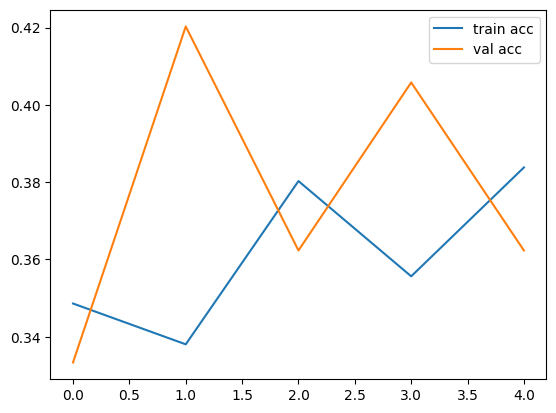

<Figure size 640x480 with 0 Axes>

In [115]:
# accuracies
plt.plot(cnn_2.history['accuracy'], label='train acc')
plt.plot(cnn_2.history['val_accuracy'], label='val acc')
plt.legend()
plt.show()
plt.savefig('AccVal_acc')

<H2>Model 3 -</H2>

In [116]:
from keras.preprocessing.image import ImageDataGenerator
from keras.models import Sequential
from keras.layers import Conv2D, MaxPooling2D
from keras.layers import Activation, Dropout, Flatten, Dense

SIZE = 224

INPUT_SHAPE = (SIZE, SIZE, 3)   #change to (SIZE, SIZE, 3)

model_cnn_3 = Sequential()
model_cnn_3.add(Conv2D(128, (4, 4), input_shape=INPUT_SHAPE))
model_cnn_3.add(Activation('relu'))
model_cnn_3.add(MaxPooling2D(pool_size=(2, 2)))

model_cnn_3.add(Conv2D(64, (3, 3)))
model_cnn_3.add(Activation('relu'))
model_cnn_3.add(MaxPooling2D(pool_size=(2, 2)))

# model_cnn_3.add(Conv2D(32, (3, 3)))
# model_cnn_3.add(Activation('relu'))
# model_cnn_3.add(MaxPooling2D(pool_size=(2, 2)))

model_cnn_3.add(Conv2D(16, (2, 2)))
model_cnn_3.add(Activation('relu'))
model_cnn_3.add(MaxPooling2D(pool_size=(2, 2)))

model_cnn_3.add(Flatten())
model_cnn_3.add(Dense(8))
model_cnn_3.add(Activation('relu'))
model_cnn_3.add(Dropout(0.1))
model_cnn_3.add(Dense(4))
model_cnn_3.add(Activation('softmax'))

# tell the model what cost and optimization method to use
model_cnn_3.compile(
  loss='categorical_crossentropy',
  optimizer='adam',
  metrics=['accuracy']
)

print(model_cnn_3.summary())

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_18 (Conv2D)          (None, 221, 221, 128)     6272      
                                                                 
 activation_28 (Activation)  (None, 221, 221, 128)     0         
                                                                 
 max_pooling2d_18 (MaxPooli  (None, 110, 110, 128)     0         
 ng2D)                                                           
                                                                 
 conv2d_19 (Conv2D)          (None, 108, 108, 64)      73792     
                                                                 
 activation_29 (Activation)  (None, 108, 108, 64)      0         
                                                                 
 max_pooling2d_19 (MaxPooli  (None, 54, 54, 64)        0         
 ng2D)                                                

In [117]:
# Fit the model
cnn_3 = model_cnn.fit(
    train_generator,  # Use the training generator
    validation_data=validation_generator,  # Use the validation generator for validation data
    epochs=5,
    steps_per_epoch=len(train_generator),
    validation_steps=len(validation_generator)
)

Epoch 1/5
9/9 [==============================] - 44s 5s/step - loss: 1.3268 - accuracy: 0.4014 - val_loss: 1.2931 - val_accuracy: 0.3913
Epoch 2/5
9/9 [==============================] - 40s 5s/step - loss: 1.3238 - accuracy: 0.3873 - val_loss: 1.3497 - val_accuracy: 0.3913
Epoch 3/5
9/9 [==============================] - 42s 5s/step - loss: 1.3554 - accuracy: 0.3486 - val_loss: 1.3555 - val_accuracy: 0.3623
Epoch 4/5
9/9 [==============================] - 42s 5s/step - loss: 1.3171 - accuracy: 0.3697 - val_loss: 1.3150 - val_accuracy: 0.4058
Epoch 5/5
9/9 [==============================] - 39s 5s/step - loss: 1.3304 - accuracy: 0.3838 - val_loss: 1.3418 - val_accuracy: 0.3623


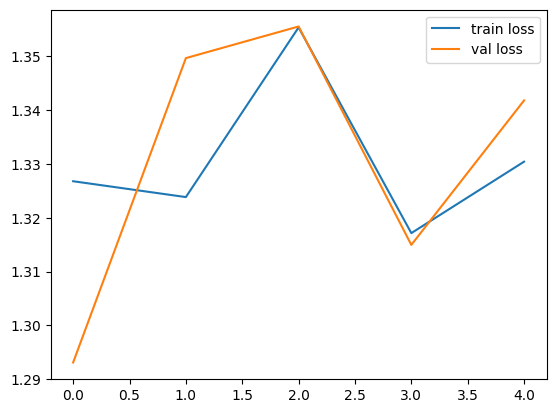

<Figure size 640x480 with 0 Axes>

In [118]:
# loss
plt.plot(cnn_3.history['loss'], label='train loss')
plt.plot(cnn_3.history['val_loss'], label='val loss')
plt.legend()
plt.show()
plt.savefig('LossVal_loss')

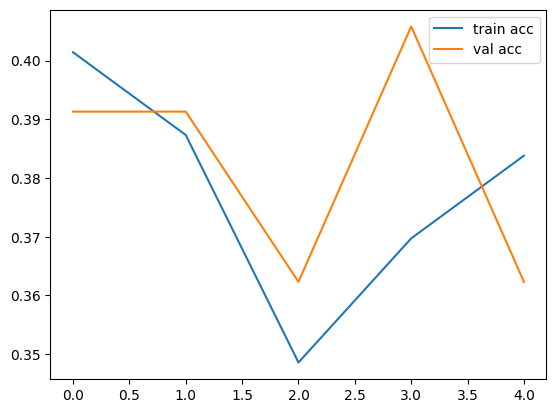

<Figure size 640x480 with 0 Axes>

In [119]:
# accuracies
plt.plot(cnn_3.history['accuracy'], label='train acc')
plt.plot(cnn_3.history['val_accuracy'], label='val acc')
plt.legend()
plt.show()
plt.savefig('AccVal_acc')

<H1>Ans 5. - </H1>
<H2> We train/test 3 models with different hyperparameters and selected the model which fits the data best.

Best Model Selected = Model_3

</H2>

1/1 [==============================] - 0s 28ms/step


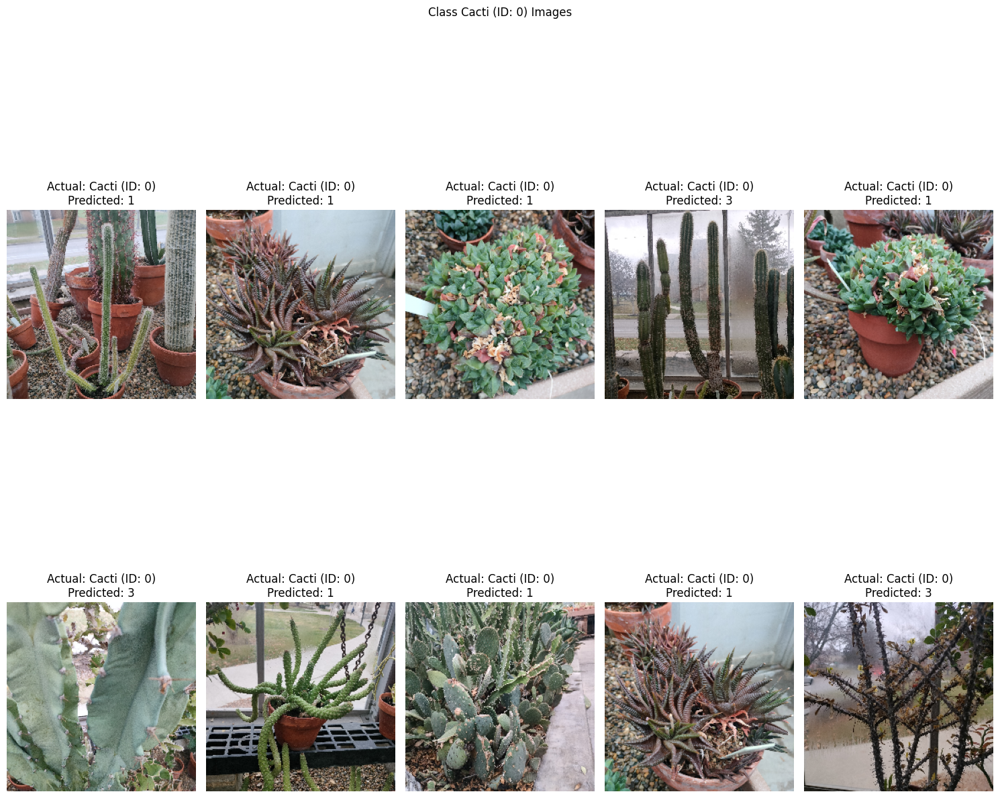

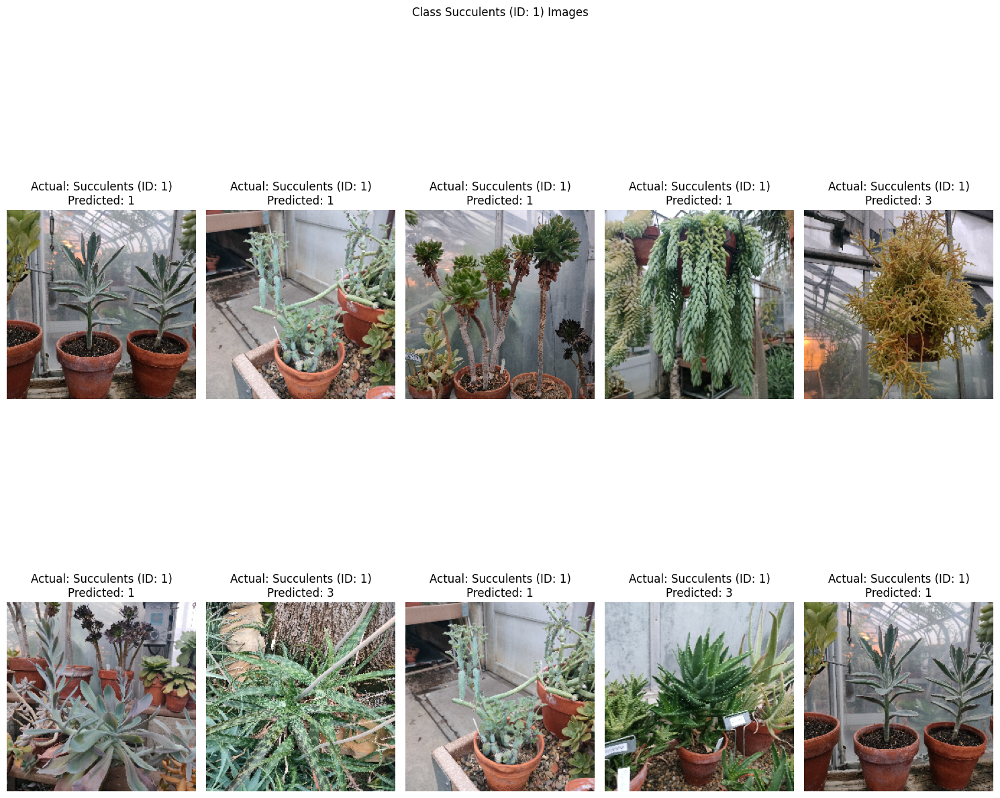

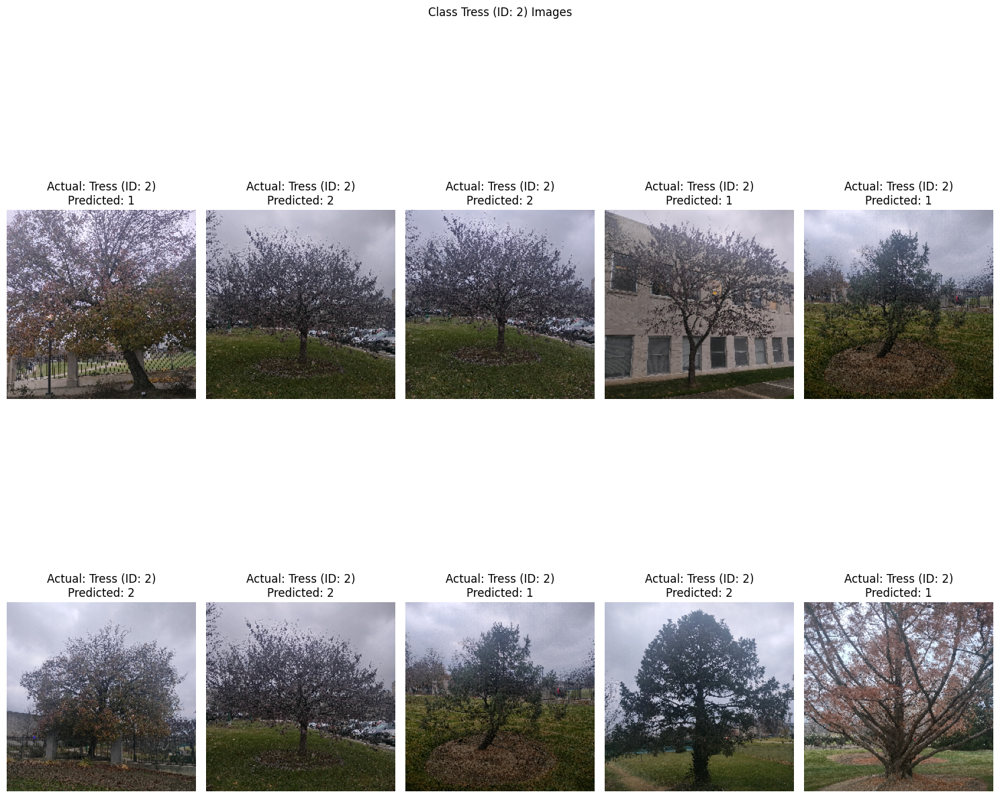

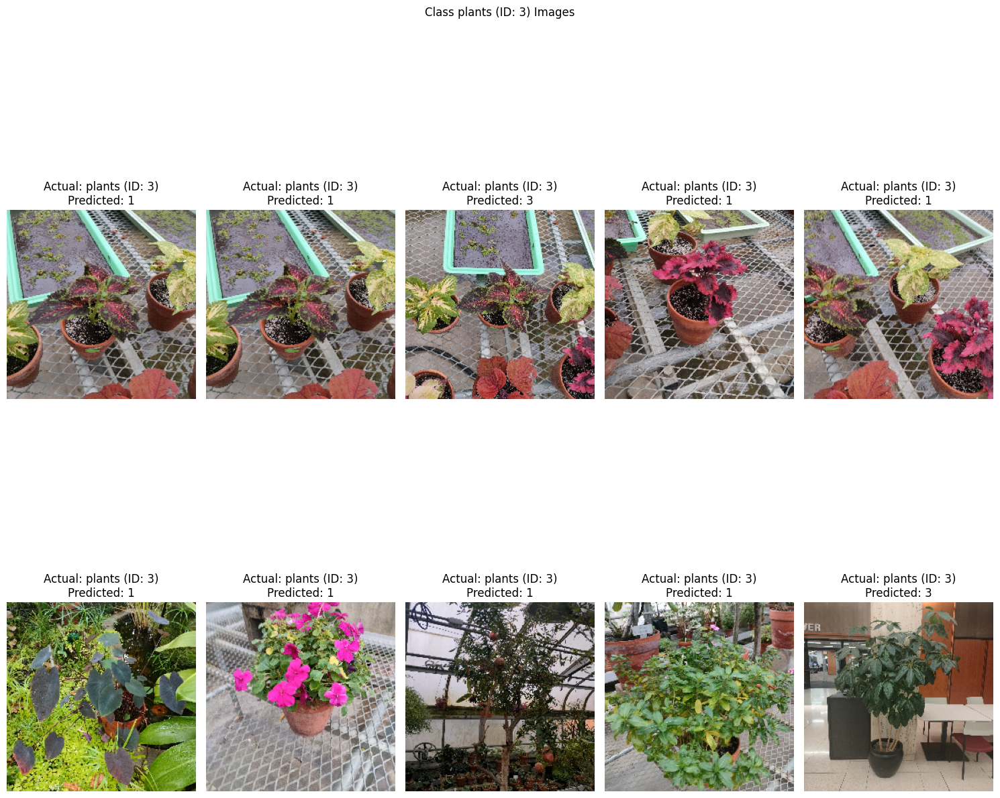

In [120]:
import matplotlib.pyplot as plt
import numpy as np

# Number of classes
num_classes = len(test_generator.class_indices)

# Initialize a dictionary to store images
class_images = {class_id: [] for class_id in range(num_classes)}
class_labels = {class_id: [] for class_id in range(num_classes)}

# Iterate over the test set to collect 10 images for each class
for test_images, test_labels in test_generator:
    # Predict the labels for this batch of test images
    predicted_labels = model_cnn_3.predict(test_images)
    predicted_labels = np.argmax(predicted_labels, axis=1)
    actual_labels = np.argmax(test_labels, axis=1)

    for i in range(len(test_images)):
        actual_label = actual_labels[i]
        # Collect images for each class
        if len(class_images[actual_label]) < 10:
            class_images[actual_label].append(test_images[i])
            class_labels[actual_label].append(predicted_labels[i])

    # Break the loop if 10 images of each class have been collected
    if all(len(images) == 10 for images in class_images.values()):
        break

# Display 10 images of each class
# Create a dictionary mapping from class ID to class name
id_to_class = {v: k for k, v in test_generator.class_indices.items()}

# Display 10 images of each class
for class_id in range(num_classes):
    plt.figure(figsize=(15, 15))
    class_name = id_to_class[class_id]  # Get the class name using class ID
    for i, (image, predicted_label) in enumerate(zip(class_images[class_id], class_labels[class_id])):
        plt.subplot(2, 5, i + 1)
        plt.imshow(image)
        plt.title(f"Actual: {class_name} (ID: {class_id})\nPredicted: {predicted_label}")
        plt.axis("off")
    plt.suptitle(f"Class {class_name} (ID: {class_id}) Images")
    plt.tight_layout()
    plt.show()

<H1> Ans 5. -</H1>
<H2>

1. As seen from the above output images, the classification accuracy is very low, with majority of classes being mis-classified.
2. 'Tree' class is being classified with a very high accuracy, whereas the other classes are being classified very poorly.
3. 'Plant' class is being classified with the higgest in-accuracy, where it is unable to classify any of the 'Plants' appropriately.
4. Therefore, we can see that additional training data is required, as the classification Accuracy is very low due to which we can say that the model is underfitting.
5. Classification Accuracy can be increased by using additional trainnig data, or making the model more complex.

</H2>